# Scratch work for Project 2

## Retrieve voteview.com data and write to csv
- Congress 113 (years 2013-2014)
- Senate only
- (Rollcall IDs: RS1170001 to RS1170528)


# 113th Congress Scratch work

From wikipedia:
https://en.wikipedia.org/wiki/113th_United_States_Congress

# Senate Democrats, who had a 55-45 majority for most of the 113th Congress

In [1]:
# Import libraries as needed

#import json
import warnings
warnings.filterwarnings('ignore')
import pandas as pd
import numpy as np
import networkx as nx
from networkx.algorithms import bipartite
import matplotlib.pyplot as plt

Read in the Senator votes by rollnumber
- rollnumber represents the vote for the Senate of that Congress and confirm successful retrieval.
- icpsr is the unique identifier of the Senator
- cast_code is the particular vote, yea, nay or other

 Cast codes
- 1 Yea
- 6 Nay
- 9 Not Voting (Abstention)
- 7 Present (some Congresses)

In [2]:
# https://voteview.com/static/data/out/votes/S113_votes.json
s113_votes_raw_df = pd.read_json('S113_votes.json')

In [3]:
s113_votes_raw_df.head()
# len: 66351
#len(s113_votes_raw_df)
# icpsr, cast_code, rollnumber

,congress,icpsr,cast_code,chamber,rollnumber,prob
0,113,14009,1,Senate,1,91.1
1,113,14203,1,Senate,1,99.4
2,113,14226,1,Senate,1,85.4
3,113,14230,1,Senate,1,99.6
4,113,14307,1,Senate,1,99.3


Trim the dataframe to only contain the icpsr, cast code and rollnumber. Note, the JSON from voteview.com contains Barack Obama votes on the Senate rollnumbers. We have removed his votes by icpsr "99911" as he was President and not a Senator.

In [4]:
# Select only the columns I want to use later
s113_votes_sel_df = s113_votes_raw_df[['icpsr', 'cast_code', 'rollnumber']]
# Convert all to string
s113_votes_sel_df = s113_votes_sel_df.astype(str)
# Remove Barack Obama from the list (icpsr==99911)
s113_votes_sel_df = s113_votes_sel_df.drop(s113_votes_sel_df[s113_votes_sel_df.icpsr == '99911'].index)
s113_votes_sel_df = s113_votes_sel_df.reset_index(drop=True)
s113_votes_sel_df.head()

,icpsr,cast_code,rollnumber
0,14009,1,1
1,14203,1,1
2,14226,1,1
3,14230,1,1
4,14307,1,1


Output length of dataframe ... 65694.

In [5]:
len(s113_votes_sel_df)

65694

Retrieve all the Unique IDs from the icpsr column, which is the unique identifier of each Senator. Confirm overall Senator count is 105. The list of Senator IDs will be needed later to define the Senator graph nodes.

In [6]:
senator_ids = s113_votes_sel_df['icpsr'].unique()

In [7]:
senator_ids

array(['14009', '14203', '14226', '14230', '14307', '14440', '14503',
       '14651', '14709', '14806', '14852', '14858', '14871', '14914',
       '14920', '14921', '14922', '15011', '15015', '15021', '15039',
       '15054', '15408', '15424', '15425', '20100', '20101', '20115',
       '20707', '20713', '20717', '20730', '20735', '20930', '21173',
       '29142', '29147', '29345', '29373', '29386', '29389', '29512',
       '29534', '29548', '29555', '29566', '29722', '29732', '29735',
       '29754', '29906', '29909', '29918', '29924', '29935', '29940',
       '39310', '40300', '40301', '40304', '40305', '40700', '40701',
       '40702', '40703', '40704', '40705', '40707', '40900', '40902',
       '40904', '40905', '40906', '40907', '40908', '40909', '40910',
       '40915', '40916', '41101', '41102', '41104', '41106', '41107',
       '41110', '41111', '41112', '41300', '41301', '41302', '41303',
       '41304', '41305', '49300', '49308', '49700', '49702', '49703',
       '49706', '946

In [8]:
len(senator_ids) # 105

105

Read in the members.json object which contains the metadata for each Senator including name, party_code, etc.

In [9]:
# https://voteview.com/static/data/out/members/S113_members.json
s113_members_raw_df = pd.read_json('S113_members.json')

In [10]:
s113_members_raw_df.head()

,congress,chamber,icpsr,state_icpsr,district_code,state_abbrev,party_code,occupancy,last_means,bioname,...,died,nominate_dim1,nominate_dim2,nominate_log_likelihood,nominate_geo_mean_probability,nominate_number_of_votes,nominate_number_of_errors,conditional,nokken_poole_dim1,nokken_poole_dim2
0,113,President,99911,99,0,USA,100,0,0,"OBAMA, Barack",...,NaN,-0.358,-0.197,-41.04464,0.88200,327,11,NaN,NaN,NaN
1,113,Senate,49700,41,0,AL,200,0,1,"SESSIONS, Jefferson Beauregard III (Jeff)",...,NaN,0.549,0.130,-101.80298,0.82789,539,45,NaN,0.619,0.082
2,113,Senate,94659,41,0,AL,200,0,1,"SHELBY, Richard C.",...,NaN,0.446,0.575,-107.47205,0.82103,545,52,NaN,0.515,0.602
3,113,Senate,40300,81,0,AK,200,0,1,"MURKOWSKI, Lisa",...,NaN,0.211,-0.304,-157.48950,0.73697,516,82,NaN,0.124,-0.411
4,113,Senate,40900,81,0,AK,100,0,1,"BEGICH, Mark",...,NaN,-0.235,0.150,-48.13809,0.91000,512,21,NaN,-0.241,0.348


Trip the dataframe to ony the necessary data.

- icpsr: Unique identifier
- state_abbrev: State Senator represents
- party_code: Political party of Senator
- bioname: Full name of Senator
- nominate_dim1: NOMINATE statistic defining the Senator idealogy on a scale of -1 to 1 with -1 being far liberal and 1 being far conservative.

Again, remove Barack Obama ("99911")

In [11]:
# icpsr, state_abbrev, party_code, bioname
s113_members_sel_df = s113_members_raw_df[['icpsr','state_abbrev','party_code','bioname','nominate_dim1']]
s113_members_sel_df = s113_members_sel_df.astype(str)
s113_members_sel_df[['nominate_dim1']] = s113_members_sel_df[['nominate_dim1']].astype(float) 
# Remove Barack Obama
s113_members_sel_df = s113_members_sel_df.drop(s113_members_sel_df[s113_members_sel_df.icpsr == '99911'].index)
s113_members_sel_df = s113_members_sel_df.reset_index(drop=True)
s113_members_sel_df.head()

,icpsr,state_abbrev,party_code,bioname,nominate_dim1
0,49700,AL,200,"SESSIONS, Jefferson Beauregard III (Jeff)",0.549
1,94659,AL,200,"SHELBY, Richard C.",0.446
2,40300,AK,200,"MURKOWSKI, Lisa",0.211
3,40900,AK,100,"BEGICH, Mark",-0.235
4,15039,AZ,200,"McCAIN, John Sidney, III",0.381


Confirm Senator count is 105 to match previous input file.

In [12]:
len(s113_members_sel_df)
# 105

105

In [13]:
s113_members_sel_df.head()
# icpsr, state_abbrev, party_code, bioname

,icpsr,state_abbrev,party_code,bioname,nominate_dim1
0,49700,AL,200,"SESSIONS, Jefferson Beauregard III (Jeff)",0.549
1,94659,AL,200,"SHELBY, Richard C.",0.446
2,40300,AK,200,"MURKOWSKI, Lisa",0.211
3,40900,AK,100,"BEGICH, Mark",-0.235
4,15039,AZ,200,"McCAIN, John Sidney, III",0.381


Check party_code values.

- 100: Democrat
- 200: Republican
- 328: Independent (for 113 Congress, both independents align idealogically with Democrats)

In [14]:
# Get unique party codes
party_codes = s113_members_sel_df['party_code'].unique()

In [15]:
party_codes
# 100 Democratic Party
# 200 Republican Party
# 328 Independent

array(['200', '100', '328'], dtype=object)

Read in rollcall votes JSON which contains the metadata for each rollnumber vote. Trim dataframe to columns:
- date: Date of vote
- rollnumber: Numerical identifier of vote for 113 Congress and Senate chamber
- bill_number: Formal bill identifier
- vote_result: Vote outcome
- vote_desc: Vote description
- clause_codes: Code to categorize content of vote

In [16]:
# https://voteview.com/static/data/out/rollcalls/S113_rollcalls.json
s113_rollcalls_raw_df = pd.read_json('S113_rollcalls.json')

In [17]:
# len is 657, is 657 votes
len(s113_rollcalls_raw_df[[]])
s113_rollcalls_sel_df = s113_rollcalls_raw_df[['date', 'rollnumber', 'bill_number', 'vote_result', 'vote_desc', 'clausen_codes']]
s113_rollcalls_sel_df['rollnumber'] = s113_rollcalls_sel_df['rollnumber'].astype(str)
s113_rollcalls_sel_df['date'] = s113_rollcalls_sel_df['date'].astype(str)
s113_rollcalls_sel_df.head()
# date, rollnumber, bill_number, vote_result, vote_desc, clausen_codes

,date,rollnumber,bill_number,vote_result,vote_desc,clausen_codes
0,2013-01-24,1,SRES15,Resolution Agreed to,A resolution to improve procedures for the con...,[Miscellaneous Policy]
1,2013-01-24,2,SRES16,Resolution Agreed to,A resolution amending the Standing Rules of th...,[Miscellaneous Policy]
2,2013-01-28,3,HR152,Amendment Rejected,To offset the cost of the bill with rescission...,[Government Management]
3,2013-01-28,4,HR152,Bill Passed,A bill making supplemental appropriations for ...,[Government Management]
4,2013-01-29,5,PN42,Nomination Confirmed,"John Forbes Kerry, of Massachusetts, to be Sec...",[Foreign and Defense Policy]


Convert Clausen Codes list to dummy variables and append to dataframe

In [18]:
#s113_rollcalls_sel_df.clausen_codes
#pd.get_dummies(df['groups'].explode()).sum(level=0)
claus_codes = pd.get_dummies(s113_rollcalls_sel_df['clausen_codes'].explode()).sum(level=0)
claus_codes.columns = ['cc_agr','cc_civ_lib','cc_for_def','cc_gov_mgmt','cc_misc','cc_soc_wel']
claus_codes

,cc_agr,cc_civ_lib,cc_for_def,cc_gov_mgmt,cc_misc,cc_soc_wel
0,0,0,0,0,1,0
1,0,0,0,0,1,0
2,0,0,0,1,0,0
3,0,0,0,1,0,0
4,0,0,1,0,0,0
...,...,...,...,...,...,...
652,0,0,1,0,0,0
653,0,0,0,1,0,0
654,0,0,0,1,0,0
655,0,0,0,1,0,0


In [19]:
s113_rollcalls_sel_df = s113_rollcalls_sel_df.reset_index(drop=True).join(claus_codes)
s113_rollcalls_sel_df = s113_rollcalls_sel_df.drop(columns=['clausen_codes'])
s113_rollcalls_sel_df.head()

,date,rollnumber,bill_number,vote_result,vote_desc,cc_agr,cc_civ_lib,cc_for_def,cc_gov_mgmt,cc_misc,cc_soc_wel
0,2013-01-24,1,SRES15,Resolution Agreed to,A resolution to improve procedures for the con...,0,0,0,0,1,0
1,2013-01-24,2,SRES16,Resolution Agreed to,A resolution amending the Standing Rules of th...,0,0,0,0,1,0
2,2013-01-28,3,HR152,Amendment Rejected,To offset the cost of the bill with rescission...,0,0,0,1,0,0
3,2013-01-28,4,HR152,Bill Passed,A bill making supplemental appropriations for ...,0,0,0,1,0,0
4,2013-01-29,5,PN42,Nomination Confirmed,"John Forbes Kerry, of Massachusetts, to be Sec...",0,0,1,0,0,0


# Clausen Categories

From: https://voteview.com/articles/issue_codes

- Government Management: Environmental control; government regulation of business; natural resource management; government ownership of business; government control of the economy; budget balancing; tax policy; interest rates; management of the bureaucracy; etc.
- Social Welfare: Social security; public housing; urban renewal; labor regulation; education; urban affairs; employment opportunities and rewards; welfare; medicare; unemployment; minimum wage; legal services; immigration, etc.
- Agriculture: Price supports and subsidies; commodity control; acreage limitations; etc.
- Civil Liberties: Civil rights; equality; criminal procedure; privacy; guarantees of the Bill of Rights; slavery; Hatch Act; etc.
- Foreign and Defense Policy: International policy; foreign aid; aid to international organizations; armament policy; defense procurement; international trade; military pensions; etc.
- Miscellaneous Policy: Unclassifiable or unidentifiable votes; all votes concerned with internal organization of Congress; procedural motions.



Check language of all possible $vote\_result$ values to be able to identify pass or fail.

In [20]:
s113_rollcalls_sel_df['vote_result'].unique()

array(['Resolution Agreed to', 'Amendment Rejected', 'Bill Passed',
       'Nomination Confirmed', 'Motion to Table Agreed to',
       'Motion to Proceed Agreed to', 'Amendment Agreed to',
       'Cloture Motion Rejected', 'Cloture Motion Agreed to',
       'Cloture on the Motion to Proceed Rejected',
       'Motion to Table Failed', 'Motion to Recommit Rejected',
       'Motion Rejected', 'Cloture on the Motion to Proceed Agreed to',
       'Motion Agreed to', 'Motion for Attendance Agreed to',
       'Motion to Table Motion to Recommit Agreed to',
       'Joint Resolution Passed', 'Motion to Proceed Rejected',
       'Motion to Adjourn Rejected', 'Motion to Reconsider Agreed to',
       'Decision of Chair Not Sustained', 'Decision of Chair Sustained',
       'Concurrent Resolution Agreed to', 'Conference Report Agreed to',
       'Bill Defeated', 'Motion to Refer Rejected',
       'Point of Order Not Well Taken'], dtype=object)

Passed votes must contain:
- 'Agreed'
- 'Passed'
- 'Confirmed'
- 'Decision of Chair Sustained'

Failed votes will contain:
- 'Rejected'
- 'Failed'
- 'Defeated'
- 'Not Well Taken'
- 'Decision of Chair Not Sustained'

In [21]:
#s113_rollcalls_raw_df[['bill_number']] = s113_rollcalls_raw_df[['bill_number']].astype(str)

In [22]:
bill_numbers = s113_rollcalls_sel_df['bill_number']
bill_numbers = list(bill_numbers)
bill_numbers = [str(x) for x in bill_numbers]
#bill_numbers

In [23]:
#bill_numbers_sort = sorted(bill_numbers)

https://www.senate.gov/legislative/KeytoLegislativeCitations.htm
- HJRES: House Joint Resolution
- HR: House Bill
- No: None
- PN: Privileged or Presidential Nomination
- S: Senate Bill
- SCONRES: Senate Concurrent Resolution
- SJRES: Senate Joint Resolution
- SRES: Simple Resolution originating in the Senate

Focus on Senate Bills, thus bill_number with 'S' followed by a number

In [24]:
# Regex to get those starting with S and a Number
import re
regex_sen_bill = re.compile(r'^S\d')
#senate_bills = [i for i in bill_numbers if regex_sen_bill.match(i)]
senate_bills = list(filter(regex_sen_bill.match, bill_numbers)) # Read Note below
#(senate_bills)

Create dictionary of key $bill\_number$ and value $rollnumber$.

In [25]:
senate_rollcall_dict = dict(zip(s113_rollcalls_sel_df.bill_number, s113_rollcalls_sel_df.rollnumber))
#senate_rollcall_dict

Create dictionary of $bill\_number$ and $vote\_result$.

In [26]:
senate_vote_result_dict = dict(zip(s113_rollcalls_raw_df.bill_number, s113_rollcalls_raw_df.vote_result))

Create dictionary of key $bill\_number$ and $vote\_result$ for just the Senate bills.

In [27]:
senate_bills_result_dict = dict((k, senate_vote_result_dict[k]) for k in senate_bills if k in senate_vote_result_dict)
#senate_bills_result_dict
# Luckily this creation of a dictionary does seem to be using the last entry and thus the final vote

Create a dictionary of key $bill\_number$ and $rollnumber$ for just the Senate bills.

In [28]:
senate_bills_dict = dict((k, senate_rollcall_dict[k]) for k in senate_bills if k in senate_rollcall_dict)
#senate_bills_dict

Convert dictionary into array of $rollnumber$ for Senate Bills

In [29]:
rollnumber_list = senate_bills_dict.values()
rollnumber_list = list(rollnumber_list)
#rollnumber_list

Trim dataframe to just Senate bills with metadata based on list of $rollnumber$ for Senate bills

In [30]:
senate_bills_df = s113_rollcalls_sel_df[s113_rollcalls_sel_df['rollnumber'].isin(rollnumber_list)]
senate_bills_df.head()

,date,rollnumber,bill_number,vote_result,vote_desc,cc_agr,cc_civ_lib,cc_for_def,cc_gov_mgmt,cc_misc,cc_soc_wel
18,2013-02-12,19,S47,Bill Passed,A bill to reauthorize the Violence Against Wom...,0,1,0,0,0,0
25,2013-02-28,26,S16,Cloture on the Motion to Proceed Rejected,A bill to provide for a sequester replacement.,0,0,0,1,0,0
26,2013-02-28,27,S388,Cloture on the Motion to Proceed Rejected,"A bill to appropriately limit sequestration, t...",0,0,0,1,0,0
104,2013-04-18,105,S649,Amendment Agreed to,To reauthorize and improve programs related to...,0,0,0,1,0,0
112,2013-05-06,113,S743,Bill Passed,A bill to restore States' sovereign rights to ...,0,0,0,1,0,0


Create Boolean column $passed$ based on the $vote\_result$ column values.

In [31]:
passed_list = ['Agreed','Passed','Confirmed', 'Decision of Chair Sustained']
def bill_passed(row):
    result = 0
    if any(word in row['vote_result'] for word in passed_list):
        result=1
    return result
senate_bills_df['passed'] = senate_bills_df.apply(bill_passed, axis=1)
senate_bills_df.head()

,date,rollnumber,bill_number,vote_result,vote_desc,cc_agr,cc_civ_lib,cc_for_def,cc_gov_mgmt,cc_misc,cc_soc_wel,passed
18,2013-02-12,19,S47,Bill Passed,A bill to reauthorize the Violence Against Wom...,0,1,0,0,0,0,1
25,2013-02-28,26,S16,Cloture on the Motion to Proceed Rejected,A bill to provide for a sequester replacement.,0,0,0,1,0,0,0
26,2013-02-28,27,S388,Cloture on the Motion to Proceed Rejected,"A bill to appropriately limit sequestration, t...",0,0,0,1,0,0,0
104,2013-04-18,105,S649,Amendment Agreed to,To reauthorize and improve programs related to...,0,0,0,1,0,0,1
112,2013-05-06,113,S743,Bill Passed,A bill to restore States' sovereign rights to ...,0,0,0,1,0,0,1


Trim the dataframe of individual votes cast to just the Senate bills by $rollnumber$.

In [32]:
#df[df['A'].isin([3, 6])]
senate_bill_votes_df = s113_votes_sel_df[s113_votes_sel_df['rollnumber'].isin(rollnumber_list)]
senate_bill_votes_df

,icpsr,cast_code,rollnumber
1799,14009,1,19
1800,14203,1,19
1801,14226,6,19
1802,14230,1,19
1803,14307,1,19
...,...,...,...
57289,49700,6,573
57290,49702,1,573
57291,49703,6,573
57292,49706,6,573


Senator 14920 is not in connected graph. Turns out that Senator never voted on a Senate bill of the 113th Congress. John Kerry, who was quickly voted in as Secretary of State.

In [33]:
# why is the one node showing up
extra_node_df = s113_votes_sel_df[s113_votes_sel_df['icpsr'] == 14920]
extra_node_df

,icpsr,cast_code,rollnumber


Create a bipartite graph of Senator nodes and Senate bill nodes

First, create Senator nodes with $icpsr$ as the key value, bipartite value as '0' along with name, party, state, and nominate dimension.

In [34]:
G = nx.Graph()

for index, sen in s113_members_sel_df.iterrows():
    G.add_node(sen.icpsr, bipartite=0, 
               name=sen.bioname,
               party=sen.party_code,
               state=sen.state_abbrev,
               nom_dim=sen.nominate_dim1)
    
len(G.nodes())

105

Create the bill nodes with rollnumber as the key value, bipartite value as '1' along with bill date, formal bill number, passed result, description, and dummy variables for the Clausen codes.

In [35]:
for index, bill in senate_bills_df.iterrows():
    G.add_node(bill.rollnumber, bipartite=1,
               date=bill.date,
               bill_number=bill.bill_number,
               passed=bill.passed,
               desc=bill.vote_desc,
               cc_agr=bill.cc_agr,
               cc_civ_lib=bill.cc_civ_lib, 
               cc_for_def=bill.cc_for_def,
               cc_gov_mgmt=bill.cc_gov_mgmt,
               cc_misc=bill.cc_misc,
               cc_soc_wel=bill.cc_soc_wel)
len(G.nodes())

141

Separate the nodes into two unique sets: Senators and Bill votes.

In [36]:
senator_nodes = {n for n, d in G.nodes(data=True) if d["bipartite"] == 0}
vote_nodes = set(G) - senator_nodes

In [37]:
len(senator_nodes)

105

In [38]:
len(vote_nodes)

36

Create the edges for each cast_code between a Senator and a bill.
- Define the weight as 1 for 'Yea', -1 for 'Nay' and 0 for all other values, Present or Abstention.

In [39]:
for index, row in senate_bill_votes_df.iterrows():
    wgt=0
    vote='0'
    if row.cast_code == '1':
        wgt = 1
    elif row.cast_code == '6':
        wgt = -1
    G.add_edge(row.icpsr, row.rollnumber, vote=row.cast_code, weight=wgt)

In [40]:
(len(G.nodes()), len(G.edges()))

(141, 3597)

In [41]:
#G.nodes()

Check if the graph is connected. The graph is not connected because 14920 (John Kerry) did not vote on any Senate bills.

In [42]:
nx.is_connected(G)

False

In [43]:
#nx.get_node_attributes(G, 'bipartite')

Retrieve the largest connected component subgraph, which contains the other 104 senators and the 36 Senate bills.

In [44]:
graphs = list(nx.connected_component_subgraphs(G))
g_s113 = graphs[0]
len(g_s113.nodes())

140

Define function to create a label map for the Networkx graph object.

In [45]:
my_labels = [ v[1]['name'] if v[1]['bipartite']==0 else v[1]['bill_number'] for v in g_s113.nodes(data=True)]
len(my_labels)
label_map = { g_s113.nodes()[i] : my_labels[i] for i in range(len(g_s113.nodes())) }

def generateLabelMapForNodes(graph):
    my_labels = [ v[1]['name'] if v[1]['bipartite']==0 else v[1]['bill_number'] for v in graph.nodes(data=True)]
    len(my_labels)
    label_map = { graph.nodes()[i] : my_labels[i] for i in range(len(graph.nodes())) }
    return label_map

Define function to create a color map for the nodes of the Networkx graph object.

In [46]:
# Assign node colors

my_node_color = [ ]

for node in g_s113.nodes(data=True):
    if node[1]['bipartite'] == 0: # Senator
        if node[1]['party'] == '100' or node[1]['party'] == '328': # Democrate
            my_node_color.append('blue')
        else: # Republican
            my_node_color.append('red')
    else: # Bill
        if node[1]['passed'] == 1: # Passed
            my_node_color.append('green')
        else: # Not Passed
            my_node_color.append('orange')
            
def generateColorMapForNodes(graph):
    my_node_color = [ ]

    for node in graph.nodes(data=True):
        if node[1]['bipartite'] == 0: # Senator
            if node[1]['party'] == '100' or node[1]['party'] == '328': # Democrate
                my_node_color.append('blue')
            else: # Republican
                my_node_color.append('red')
        else: # Bill
            if node[1]['passed'] == 1: # Passed
                my_node_color.append('green')
            else: # Not Passed
                my_node_color.append('orange')
    return my_node_color

Define function to create a color map for the edges of the Networkx graph object.

In [47]:
# Assign edge colors and weights based on role attribute.

my_edge_color = [ ]

for ed in g_s113.edges(data=True):
    if ed[2]['vote'] == '1':
        my_edge_color.append('green')
    elif ed[2]['vote'] == '6':
        my_edge_color.append('orange')
    else:
        my_edge_color.append('gray')

def generateColorMapForEdges(graph):
    my_edge_color = [ ]

    for ed in graph.edges(data=True):
        if ed[2]['vote'] == '1':
            my_edge_color.append('green')
        elif ed[2]['vote'] == '6':
            my_edge_color.append('orange')
        else:
            my_edge_color.append('gray')
    return my_edge_color

Separate the nodes into three sets: Republican nodes, Democrat Nodes, and Bill vote nodes in order to properly position the nodes for display of bipartite graph with three columns.

In [48]:
# Assign the position

# Separate into 3 sets
senator_nodes = {n for n, d in g_s113.nodes(data=True) if d["bipartite"] == 0}
vote_nodes = set(g_s113) - senator_nodes
rep_nodes = {n for n, d in g_s113.nodes(data=True) if d["bipartite"] == 0 and d["party"] == '200'}
dem_nodes = {n for n, d in g_s113.nodes(data=True) if d["bipartite"] == 0 and (d["party"] == '100' or d["party"] == '328')}

Assign the x-axis of the position based on the set of the node.

In [49]:
# Separate by group
pos = {}

# Update position for node from each group
pos.update((node, (1, index)) for index, node in enumerate(dem_nodes))
pos.update((node, (2, index)) for index, node in enumerate(vote_nodes))
pos.update((node, (3, index)) for index, node in enumerate(rep_nodes))

Assign the x-axis of the position based on the NOMINATE dimension of each node.

In [50]:
# Separate by group
pos_nom_dim = {}

# Update position for node from each group
pos_nom_dim.update((node, (s113_members_sel_df.loc[s113_members_sel_df['icpsr'] == node, 'nominate_dim1'].item(), index)) for index, node in enumerate(dem_nodes))
pos_nom_dim.update((node, (0, index+11)) for index, node in enumerate(vote_nodes))
pos_nom_dim.update((node, (s113_members_sel_df.loc[s113_members_sel_df['icpsr'] == node, 'nominate_dim1'].item(), index+6)) for index, node in enumerate(rep_nodes))

Confirm the graph is connected.

In [51]:
# graph[0] has all the nodes and edges
# graph[1] contains just a single node 14920, who did not vote on anything
nx.is_connected(g_s113)

True

Plot the graph of all the nodes, all the edges and x-axis value based on the NOMINATE dimension.

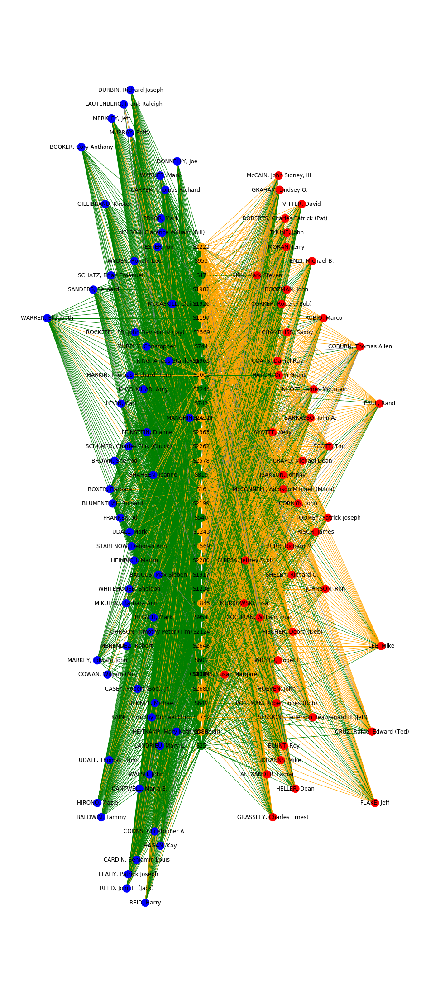

In [52]:
plt.figure(figsize = (16, 40))
plt.tight_layout()
plt.axis("off")
nx.draw_networkx(g_s113, 
                 node_color = my_node_color,
                 edge_color = my_edge_color,
                 labels = label_map,
                 pos = pos_nom_dim)

Above plot shows the democrats on the left, Republicans on the right, Senate bills in the middle
- Bills passed in Green, not Passed in Orange
- Edge represents the Yea (green) or Nay (orange) of each Senator per the bill

As expected, for a Congress with a majority Democrats, the bills that come to a voate (out of commiittee ) are bound to be Democrate friendly and thusa majority of the voting reflects the partisan deivide. with green "yea" votes by Democreats and orange "nay" votes by Republicans.

Write graph object to .graphml for inspection with Gephi.

In [53]:
graphml_file = "S113_voting.graphml"
nx.write_graphml( g_s113, graphml_file )

Next, we remove all No votes to see if a clearly pattern emerges with just the 'Yea' votes.

In [54]:
dict_edge = nx.get_edge_attributes(g_s113, "vote")
dict_edge_remove = {key:val for key, val in dict_edge.items() if val == '6'}

In [55]:
g_s113_yes_edges = g_s113
g_s113_yes_edges.remove_edges_from(list(dict_edge_remove))

In [56]:
# Update map of edges
edge_map = generateColorMapForEdges(g_s113_yes_edges)

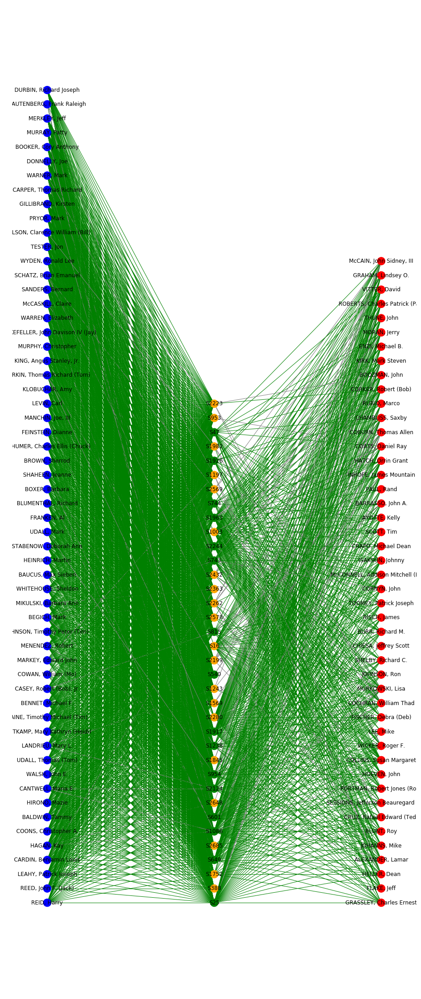

In [57]:
plt.figure(figsize = (16, 40))
plt.tight_layout()
plt.axis("off")
nx.draw_networkx(g_s113_yes_edges, 
                 node_color = my_node_color,
                 edge_color = edge_map,
                 labels = label_map,
                 pos = pos)

By removing the 'Nay' votes, we do see some bills with predominantly 'Yea' votes by Republicans.

Now, let's inverse the above and only display 'Nay' votes.

In [58]:
dict_edge = nx.get_edge_attributes(g_s113, "vote")
dict_edge_remove = {key:val for key, val in dict_edge.items() if val == '1'}

In [59]:
# Reset g_s113 graph
graphs = list(nx.connected_component_subgraphs(G))
g_s113 = graphs[0]
g_s113_no_edges = g_s113
g_s113_no_edges.remove_edges_from(list(dict_edge_remove))

In [60]:
# Update map of edges
edge_map = generateColorMapForEdges(g_s113_no_edges)

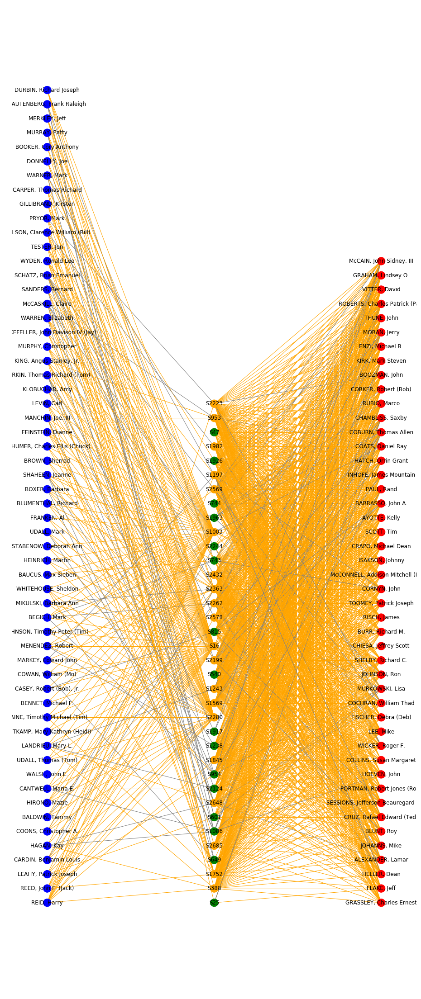

In [61]:
plt.figure(figsize = (16, 40))
plt.tight_layout()
plt.axis("off")
nx.draw_networkx(g_s113_no_edges, 
                 node_color = my_node_color,
                 edge_color = edge_map,
                 labels = label_map,
                 pos = pos)

We do see the majority of 'Nay' votes are cast by Republicans and three bills receive a high number of 'Nay' votes by Democreats. (S16, S2280, S1003).

Now, let's show just the bills that passed.

In [62]:
# Reset g_s113 graph
graphs = list(nx.connected_component_subgraphs(G))
g_s113 = graphs[0]
# Get all the nodes with Passed = 0
bills_not_passed_nodes = {n for n, d in g_s113.nodes(data=True) if d["bipartite"] == 1 and d['passed'] == 0}
# Get all the edges connected to Removed Nodes
edges_to_remove = nx.edges(g_s113, bills_not_passed_nodes)
# Remove those nodes from the Graph
g_s113_passed_bills = g_s113
g_s113_passed_bills.remove_nodes_from(bills_not_passed_nodes)
# Remove those edges
g_s113_passed_bills.remove_edges_from(edges_to_remove)
# EdgeColorMap
node_map = generateColorMapForNodes(g_s113_passed_bills)
edge_map = generateColorMapForEdges(g_s113_passed_bills)
label_map = generateLabelMapForNodes(g_s113_passed_bills)

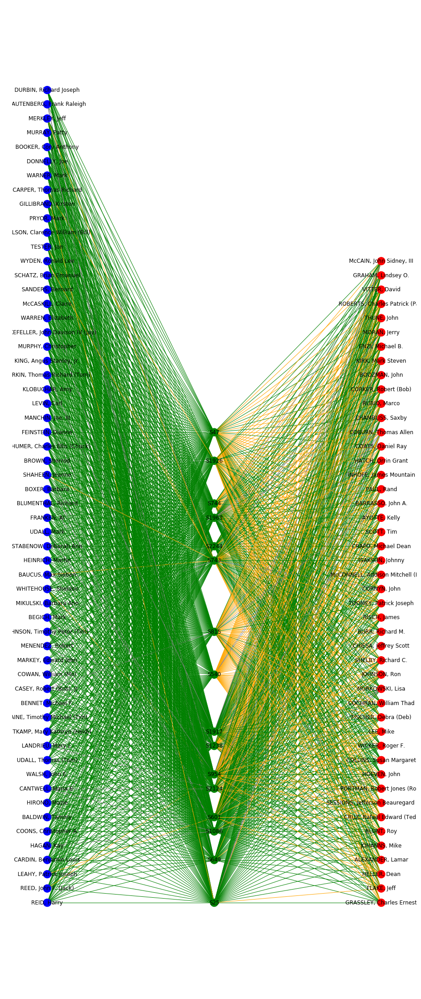

In [63]:
# Plot
plt.figure(figsize = (16, 40))
plt.tight_layout()
plt.axis("off")
nx.draw_networkx(g_s113_passed_bills, 
                 node_color = node_map,
                 edge_color = edge_map,
                 labels = label_map,
                 pos = pos)

16 bills passed. And clearly each passing bill had high Democratic support.

Now, only bills that did not pass.

In [64]:
# Reset g_s113 graph
graphs = list(nx.connected_component_subgraphs(G))
g_s113 = graphs[0]
# Get all the nodes with Passed = 0
bills_passed_nodes = {n for n, d in g_s113.nodes(data=True) if d["bipartite"] == 1 and d['passed'] == 1}
# Get all the edges connected to Removed Nodes
edges_to_remove = nx.edges(g_s113, bills_passed_nodes)
# Remove those nodes from the Graph
g_s113_not_passed_bills = g_s113
g_s113_not_passed_bills.remove_nodes_from(bills_passed_nodes)
# Remove those edges
g_s113_not_passed_bills.remove_edges_from(edges_to_remove)
# EdgeColorMap
node_map = generateColorMapForNodes(g_s113_not_passed_bills)
edge_map = generateColorMapForEdges(g_s113_not_passed_bills)
label_map = generateLabelMapForNodes(g_s113_not_passed_bills)

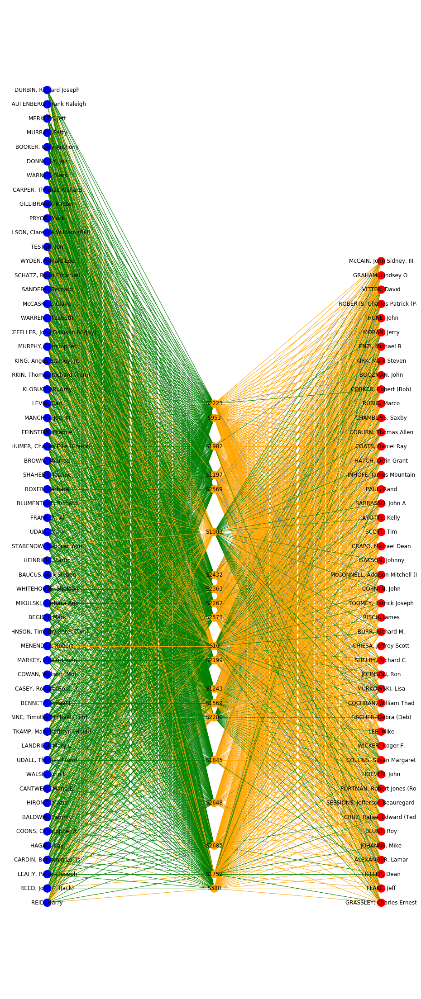

In [65]:
# Plot
plt.figure(figsize = (16, 40))
plt.tight_layout()
plt.axis("off")
nx.draw_networkx(g_s113_not_passed_bills, 
                 node_color = node_map,
                 edge_color = edge_map,
                 labels = label_map,
                 pos = pos)

20 bills did not pass. Here we see two bills with the inverse of expectations: high Republican support and low Democratic support (S16, S1003).

### Bills by Clausen code
First, Agriculture bills

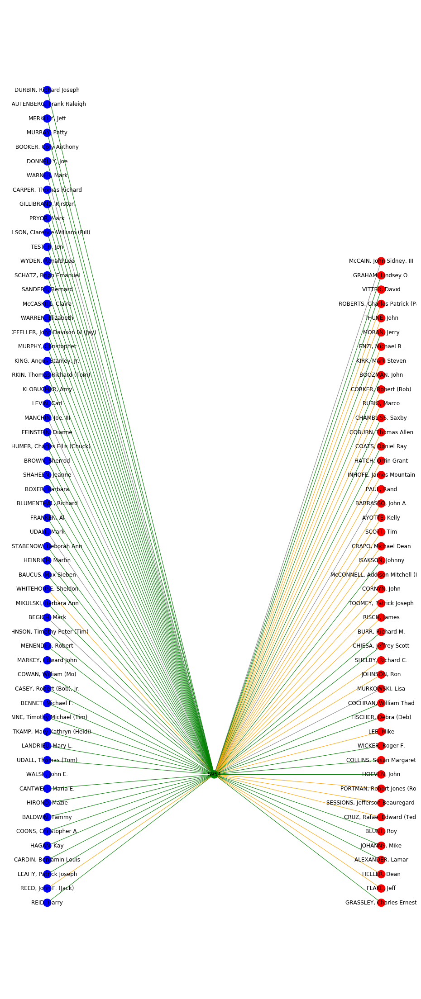

In [66]:
# Reset g_s113 graph
graphs = list(nx.connected_component_subgraphs(G))
g_s113 = graphs[0]
# Get all the nodes with cc_agr = 0, these will be nodes to remove in order to focus on Agriculture
nodes_to_remove = {n for n, d in g_s113.nodes(data=True) if d["bipartite"] == 1 and d['cc_agr'] == 0}
# Get all the edges connected to Removed Nodes
edges_to_remove = nx.edges(g_s113, nodes_to_remove)
# Remove those nodes from the Graph
g_s113_bills_cc_agr = g_s113
g_s113_bills_cc_agr.remove_nodes_from(nodes_to_remove)
# Remove those edges
g_s113_bills_cc_agr.remove_edges_from(edges_to_remove)
# EdgeColorMap
node_map = generateColorMapForNodes(g_s113_bills_cc_agr)
edge_map = generateColorMapForEdges(g_s113_bills_cc_agr)
label_map = generateLabelMapForNodes(g_s113_bills_cc_agr)

# Plot
plt.figure(figsize = (16, 40))
plt.tight_layout()
plt.axis("off")
nx.draw_networkx(g_s113_bills_cc_agr, 
                 node_color = node_map,
                 edge_color = edge_map,
                 labels = label_map,
                 pos = pos)

Civil Liberties bills

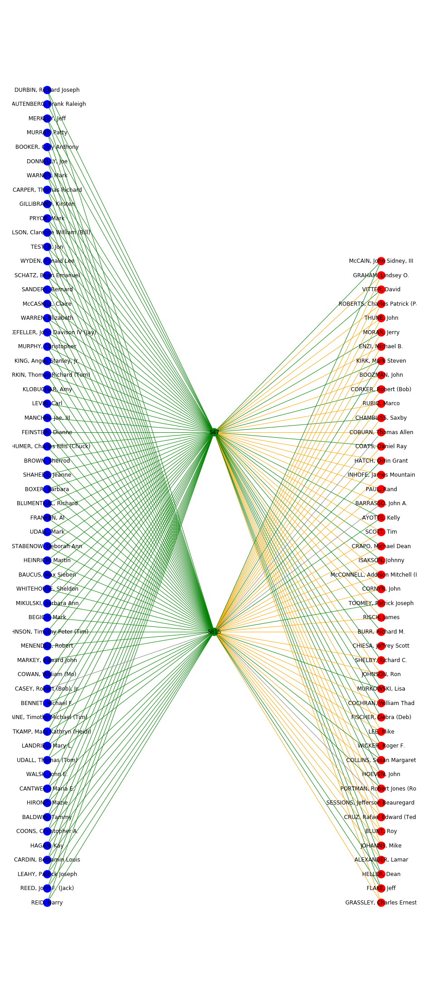

In [67]:
# Reset g_s113 graph
graphs = list(nx.connected_component_subgraphs(G))
g_s113 = graphs[0]
# Get all the nodes with cc_agr = 0, these will be nodes to remove in order to focus on Civil Liberties
nodes_to_remove = {n for n, d in g_s113.nodes(data=True) if d["bipartite"] == 1 and d['cc_civ_lib'] == 0}
# Get all the edges connected to Removed Nodes
edges_to_remove = nx.edges(g_s113, nodes_to_remove)
# Remove those nodes from the Graph
g_s113_bills_cc_agr = g_s113
g_s113_bills_cc_agr.remove_nodes_from(nodes_to_remove)
# Remove those edges
g_s113_bills_cc_agr.remove_edges_from(edges_to_remove)
# EdgeColorMap
node_map = generateColorMapForNodes(g_s113_bills_cc_agr)
edge_map = generateColorMapForEdges(g_s113_bills_cc_agr)
label_map = generateLabelMapForNodes(g_s113_bills_cc_agr)

# Plot
plt.figure(figsize = (16, 40))
plt.tight_layout()
plt.axis("off")
nx.draw_networkx(g_s113_bills_cc_agr, 
                 node_color = node_map,
                 edge_color = edge_map,
                 labels = label_map,
                 pos = pos)

Defense and Foriegn Policy bills

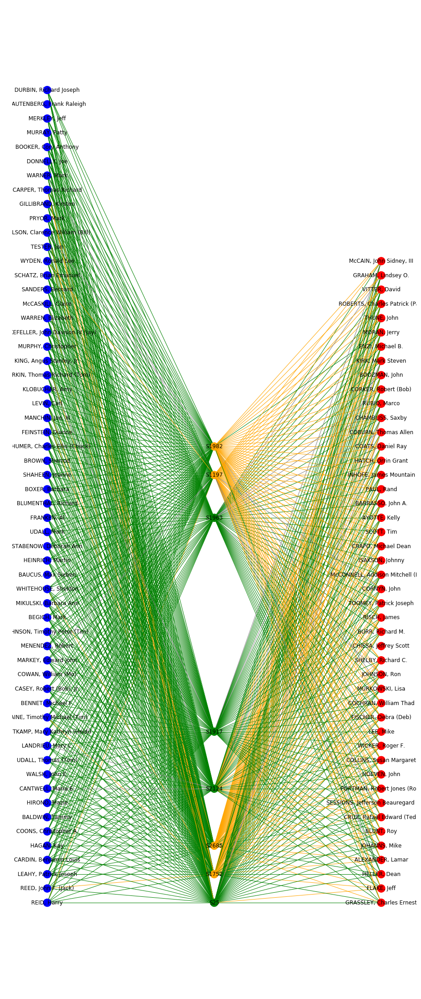

In [68]:
# ['cc_agr','cc_civ_lib','cc_for_def','cc_gov_mgmt','cc_misc','cc_soc_wel']
# Reset g_s113 graph
graphs = list(nx.connected_component_subgraphs(G))
g_s113 = graphs[0]
# Get all the nodes with cc_agr = 0, these will be nodes to remove in order to focus on Defense and Foreign Policy
nodes_to_remove = {n for n, d in g_s113.nodes(data=True) if d["bipartite"] == 1 and d['cc_for_def'] == 0}
# Get all the edges connected to Removed Nodes
edges_to_remove = nx.edges(g_s113, nodes_to_remove)
# Remove those nodes from the Graph
g_s113_bills_cc_agr = g_s113
g_s113_bills_cc_agr.remove_nodes_from(nodes_to_remove)
# Remove those edges
g_s113_bills_cc_agr.remove_edges_from(edges_to_remove)
# EdgeColorMap
node_map = generateColorMapForNodes(g_s113_bills_cc_agr)
edge_map = generateColorMapForEdges(g_s113_bills_cc_agr)
label_map = generateLabelMapForNodes(g_s113_bills_cc_agr)

# Plot
plt.figure(figsize = (16, 40))
plt.tight_layout()
plt.axis("off")
nx.draw_networkx(g_s113_bills_cc_agr, 
                 node_color = node_map,
                 edge_color = edge_map,
                 labels = label_map,
                 pos = pos)

Government Management bills

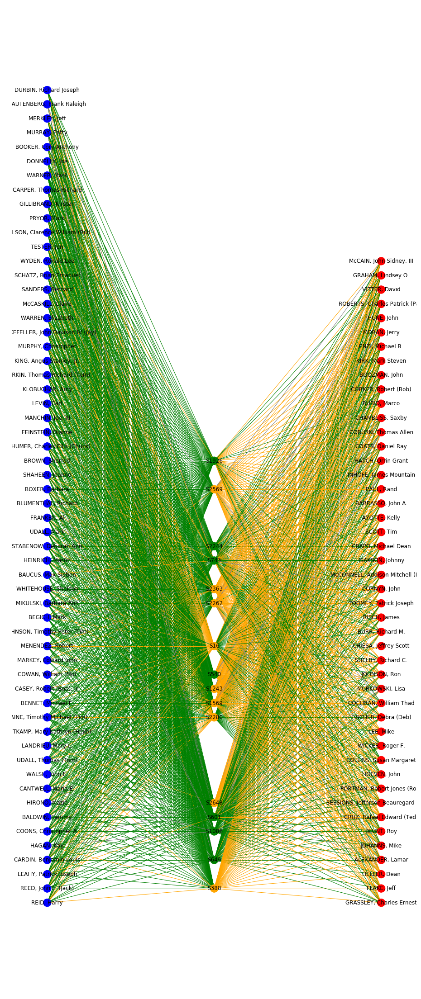

In [69]:
# ['cc_agr','cc_civ_lib','cc_for_def','cc_gov_mgmt','cc_misc','cc_soc_wel']
# Reset g_s113 graph
graphs = list(nx.connected_component_subgraphs(G))
g_s113 = graphs[0]
# Get all the nodes with cc_agr = 0, these will be nodes to remove in order to focus on Govt Mgmt
nodes_to_remove = {n for n, d in g_s113.nodes(data=True) if d["bipartite"] == 1 and d['cc_gov_mgmt'] == 0}
# Get all the edges connected to Removed Nodes
edges_to_remove = nx.edges(g_s113, nodes_to_remove)
# Remove those nodes from the Graph
g_s113_bills_cc_agr = g_s113
g_s113_bills_cc_agr.remove_nodes_from(nodes_to_remove)
# Remove those edges
g_s113_bills_cc_agr.remove_edges_from(edges_to_remove)
# EdgeColorMap
node_map = generateColorMapForNodes(g_s113_bills_cc_agr)
edge_map = generateColorMapForEdges(g_s113_bills_cc_agr)
label_map = generateLabelMapForNodes(g_s113_bills_cc_agr)

# Plot
plt.figure(figsize = (16, 40))
plt.tight_layout()
plt.axis("off")
nx.draw_networkx(g_s113_bills_cc_agr, 
                 node_color = node_map,
                 edge_color = edge_map,
                 labels = label_map,
                 pos = pos)

Misc. Policy bills

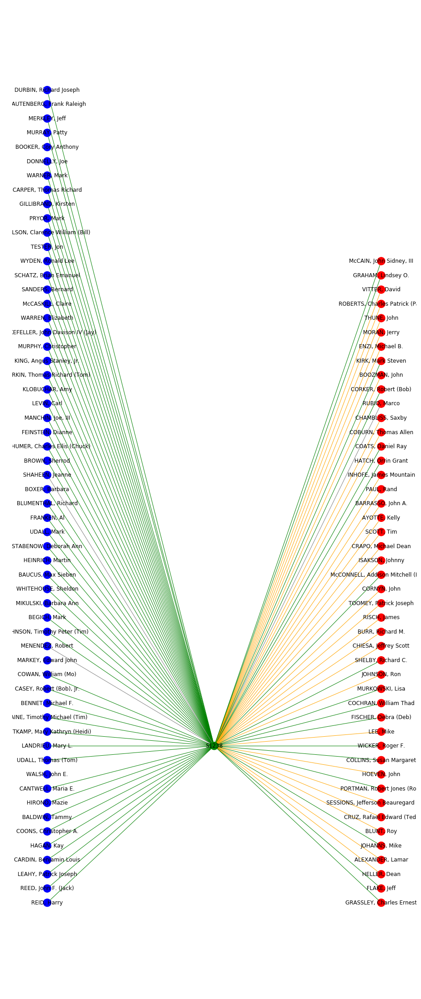

In [70]:
# ['cc_agr','cc_civ_lib','cc_for_def','cc_gov_mgmt','cc_misc','cc_soc_wel']
# Reset g_s113 graph
graphs = list(nx.connected_component_subgraphs(G))
g_s113 = graphs[0]
# Get all the nodes with cc_agr = 0, these will be nodes to remove in order to focus on Misc. Policy
nodes_to_remove = {n for n, d in g_s113.nodes(data=True) if d["bipartite"] == 1 and d['cc_misc'] == 0}
# Get all the edges connected to Removed Nodes
edges_to_remove = nx.edges(g_s113, nodes_to_remove)
# Remove those nodes from the Graph
g_s113_bills_cc_agr = g_s113
g_s113_bills_cc_agr.remove_nodes_from(nodes_to_remove)
# Remove those edges
g_s113_bills_cc_agr.remove_edges_from(edges_to_remove)
# EdgeColorMap
node_map = generateColorMapForNodes(g_s113_bills_cc_agr)
edge_map = generateColorMapForEdges(g_s113_bills_cc_agr)
label_map = generateLabelMapForNodes(g_s113_bills_cc_agr)

# Plot
plt.figure(figsize = (16, 40))
plt.tight_layout()
plt.axis("off")
nx.draw_networkx(g_s113_bills_cc_agr, 
                 node_color = node_map,
                 edge_color = edge_map,
                 labels = label_map,
                 pos = pos)

Social Welfare bills

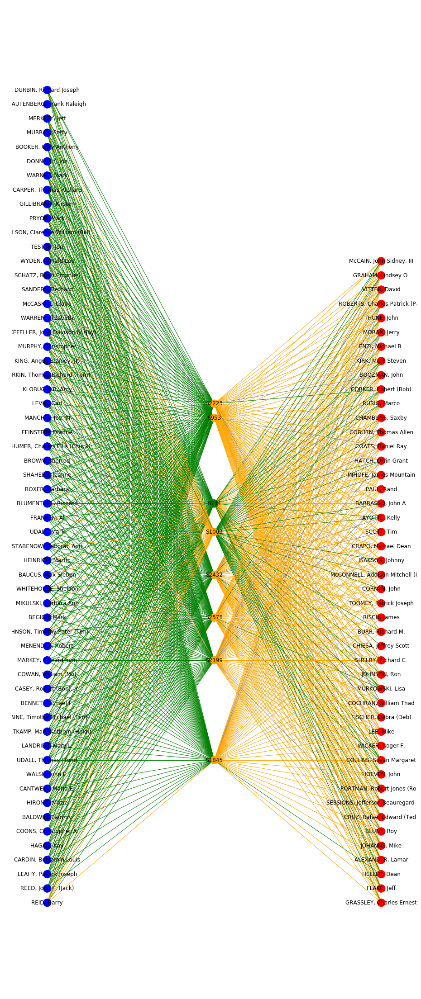

In [71]:
# ['cc_agr','cc_civ_lib','cc_for_def','cc_gov_mgmt','cc_misc','cc_soc_wel']
# Reset g_s113 graph
graphs = list(nx.connected_component_subgraphs(G))
g_s113 = graphs[0]
# Get all the nodes with cc_agr = 0, these will be nodes to remove in order to focus on Social Welfare
nodes_to_remove = {n for n, d in g_s113.nodes(data=True) if d["bipartite"] == 1 and d['cc_soc_wel'] == 0}
# Get all the edges connected to Removed Nodes
edges_to_remove = nx.edges(g_s113, nodes_to_remove)
# Remove those nodes from the Graph
g_s113_bills_cc_agr = g_s113
g_s113_bills_cc_agr.remove_nodes_from(nodes_to_remove)
# Remove those edges
g_s113_bills_cc_agr.remove_edges_from(edges_to_remove)
# EdgeColorMap
node_map = generateColorMapForNodes(g_s113_bills_cc_agr)
edge_map = generateColorMapForEdges(g_s113_bills_cc_agr)
label_map = generateLabelMapForNodes(g_s113_bills_cc_agr)

# Plot
plt.figure(figsize = (16, 40))
plt.tight_layout()
plt.axis("off")
nx.draw_networkx(g_s113_bills_cc_agr, 
                 node_color = node_map,
                 edge_color = edge_map,
                 labels = label_map,
                 pos = pos)

# Island Method
Attempting to create graph with Vote Y Nodes and Vote N Nodes in order to allow for Island Method applied to on the defense nodes.

In [72]:
G_bills_split = nx.Graph()

for index, sen in s113_members_sel_df.iterrows():
    G_bills_split.add_node(sen.icpsr, bipartite=0, 
                           name=sen.bioname,
                           party=sen.party_code,
                           state=sen.state_abbrev,
                           nom_dim=sen.nominate_dim1)
    
len(G_bills_split.nodes())

105

In [73]:
# Loop through the bills and only add defense bills twice
for index, bill in senate_bills_df.iterrows():
    if bill.cc_for_def == 1:
        node_id = bill.rollnumber + '-P'
        G_bills_split.add_node(node_id, bipartite=1,
                   date=bill.date,
                   bill_number=bill.bill_number,
                   #passed=bill.passed,
                   desc=bill.vote_desc,
                   passed=1)
        node_id = bill.rollnumber + '-NP'
        G_bills_split.add_node(node_id, bipartite=1,
                   date=bill.date,
                   bill_number=bill.bill_number,
                   #passed=bill.passed,
                   desc=bill.vote_desc,
                   passed=0)
len(G_bills_split.nodes())

121

In [74]:
#G_bills_split.nodes()

In [75]:
senator_nodes = {n for n, d in G_bills_split.nodes(data=True) if d["bipartite"] == 0}
vote_nodes = set(G_bills_split) - senator_nodes

In [76]:
len(senator_nodes)

105

In [146]:
len(vote_nodes)

14

In [78]:
for index, row in senate_bill_votes_df.iterrows():
    # Only consider the def bill roll numbers TODO: could be better written instead of hard-coded
    if row.rollnumber in [ '245','317','326','337','350','353','370','573']:
        if row.cast_code == '1':
            G_bills_split.add_edge(row.icpsr, row.rollnumber+'-P')
        elif row.cast_code == '6':
            G_bills_split.add_edge(row.icpsr, row.rollnumber+'-NP')

In [79]:
(len(G_bills_split.nodes()), len(G_bills_split.edges()))

(121, 776)

In [80]:
#G_bills_split.nodes()

In [81]:
nx.is_connected(G_bills_split)

False

In [82]:
#nx.get_node_attributes(G, 'bipartite')

In [83]:
graphs = list(nx.connected_component_subgraphs(G_bills_split))
g_s113_bill_split = graphs[0]
len(g_s113_bill_split.nodes()) #121 to 115, 6 were removed TODO

115

In [84]:
len(graphs)

7

In [85]:
graphs[4].nodes()
# 1 14920
# 2 41306
# 3 14914
# 4 41307
# 5 317-NP
# 6 353-NP

['41307']

In [86]:
my_labels = [ v[1]['name'] if v[1]['bipartite']==0 else v[1]['bill_number'] for v in g_s113_bill_split.nodes(data=True)]
#len(my_labels)
label_map = { g_s113_bill_split.nodes()[i] : my_labels[i] for i in range(len(g_s113_bill_split.nodes())) }

def generateLabelMapForNodes(graph):
    my_labels = [ v[1]['name'] if v[1]['bipartite']==0 else v[1]['bill_number'] for v in graph.nodes(data=True)]
    len(my_labels)
    label_map = { graph.nodes()[i] : my_labels[i] for i in range(len(graph.nodes())) }
    return label_map

In [87]:
# Assign node colors

my_node_color = [ ]

for node in g_s113_bill_split.nodes(data=True):
    if node[1]['bipartite'] == 0: # Senator
        if node[1]['party'] == '100' or node[1]['party'] == '328': # Democrate
            my_node_color.append('blue')
        else: # Republican
            my_node_color.append('red')
    else: # Bill
        if node[1]['passed'] == 1: # Passed
            my_node_color.append('green')
        else: # Not Passed
            my_node_color.append('orange')
            
def generateColorMapForNodes(graph):
    my_node_color = [ ]

    for node in graph.nodes(data=True):
        if node[1]['bipartite'] == 0: # Senator
            if node[1]['party'] == '100' or node[1]['party'] == '328': # Democrate
                my_node_color.append('blue')
            else: # Republican
                my_node_color.append('red')
        else: # Bill
            if node[1]['passed'] == 1: # Passed
                my_node_color.append('green')
            else: # Not Passed
                my_node_color.append('orange')
    return my_node_color

# Assign edge colors and weights based on role attribute.
# No Edge colors for split bill nodes
my_edge_color = [ ]

for ed in g_s113_bill_split.edges(data=True):
    if ed[2]['vote'] == '1':
        my_edge_color.append('green')
    elif ed[2]['vote'] == '6':
        my_edge_color.append('orange')
    else:
        my_edge_color.append('gray')

def generateColorMapForEdges(graph):
    my_edge_color = [ ]

    for ed in graph.edges(data=True):
        if ed[2]['vote'] == '1':
            my_edge_color.append('green')
        elif ed[2]['vote'] == '6':
            my_edge_color.append('orange')
        else:
            my_edge_color.append('gray')
    return my_edge_color

In [88]:
# Assign the position

# Separate into 3 sets
senator_nodes = {n for n, d in g_s113_bill_split.nodes(data=True) if d["bipartite"] == 0}
vote_nodes = set(g_s113_bill_split) - senator_nodes
rep_nodes = {n for n, d in g_s113_bill_split.nodes(data=True) if d["bipartite"] == 0 and d["party"] == '200'}
dem_nodes = {n for n, d in g_s113_bill_split.nodes(data=True) if d["bipartite"] == 0 and (d["party"] == '100' or d["party"] == '328')}

In [89]:
# Separate by group
pos = {}

# Update position for node from each group
pos.update((node, (1, index)) for index, node in enumerate(dem_nodes))
pos.update((node, (2, index)) for index, node in enumerate(vote_nodes))
pos.update((node, (3, index)) for index, node in enumerate(rep_nodes))

In [90]:
# Separate by group
pos_nom_dim = {}

# Update position for node from each group
pos_nom_dim.update((node, (s113_members_sel_df.loc[s113_members_sel_df['icpsr'] == node, 'nominate_dim1'].item(), index)) for index, node in enumerate(dem_nodes))
pos_nom_dim.update((node, (0, index+11)) for index, node in enumerate(vote_nodes))
pos_nom_dim.update((node, (s113_members_sel_df.loc[s113_members_sel_df['icpsr'] == node, 'nominate_dim1'].item(), index+6)) for index, node in enumerate(rep_nodes))

In [91]:
# graph[0] has all the nodes and edges
# graph[1] contains just a single node 14920, who did not vote on anything
nx.is_connected(g_s113_bill_split)

True

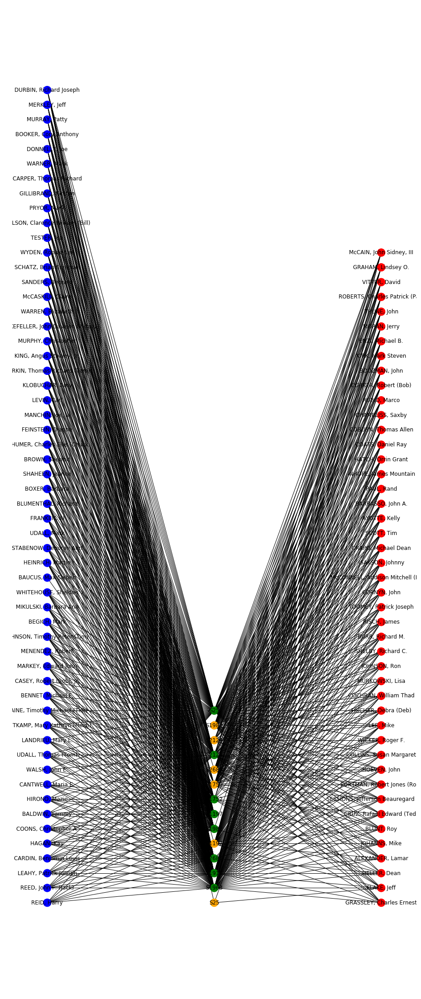

In [92]:
# TODO: Make all the edges gray
plt.figure(figsize = (16, 40))
plt.tight_layout()
plt.axis("off")
nx.draw_networkx(g_s113_bill_split, 
                 node_color = my_node_color,
                 #edge_color = my_edge_color,
                 labels = label_map,
                 pos = pos)

In [93]:
# apply island method to just this graph
#import numpy as np
#import pandas as pd
import math
import seaborn as sns
#import networkx as nx
#import networkx.algorithms.bipartite as bipartite
#from sklearn.decomposition import PCA
#from sklearn import preprocessing
# Reset figure size for plots
#plt.rcParams.update(plt.rcParamsDefault)

In [94]:
# project bipartite graph onto women nodes keeping number of co-occurence
# the degree computed is weighted and counts the total number of shared contacts
W = bipartite.weighted_projected_graph(g_s113_bill_split, senator_nodes, ratio=False)

In [95]:
weights=[math.log(edata['weight']) for f,t,edata in W.edges(data=True)]

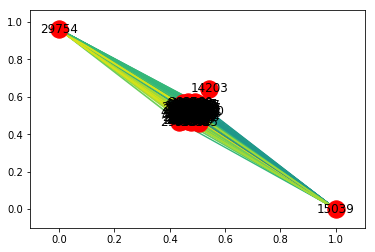

In [96]:
nx.draw_networkx(W, width=weights, edge_color=weights)

In [97]:
senators_wgt_dict = {}
for s in senator_nodes:
        senators_wgt_dict[s] = (W.degree(s,weight='weight'))
dt={k: v for k, v in sorted(senators_wgt_dict.items(), key=lambda item: item[1], reverse=True)}
df=pd.DataFrame.from_dict(dt, orient='index').reset_index()
df.columns = ['Senator','Degree']
df

,Senator,Degree
0,29940,576
1,41303,576
2,15425,576
3,29389,576
4,14858,576
...,...,...
96,29534,427
97,29512,357
98,20115,355
99,29555,280


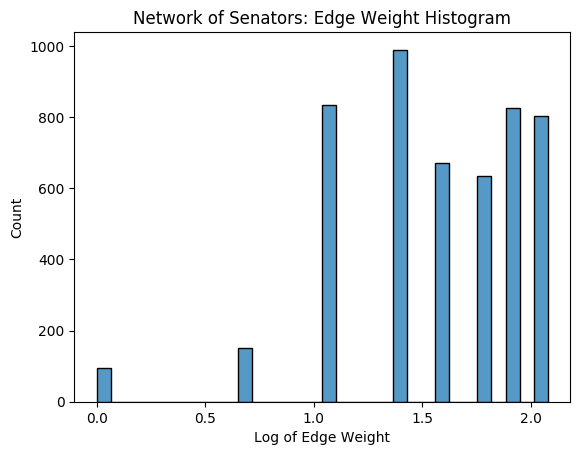

In [98]:
# Need to create histogram of the weights
plt.rcParams.update(plt.rcParamsDefault)
sns.histplot(data=weights).set(title='Network of Senators: Edge Weight Histogram', xlabel='Log of Edge Weight', ylabel='Count');

In [99]:
# From textbook
def trim_edges(g, weight=1):
    g2=nx.Graph()
    for f, to, edata in g.edges(data=True):
        if edata['weight'] > weight:
            g2.add_edge(f,to,edata)
    return g2

def trim_edges_inverse(g, weight=1):
    g2=nx.Graph()
    for f, to, edata in g.edges(data=True):
        if edata['weight'] < weight:
            g2.add_edge(f,to,edata)
    return g2

In [109]:
## The weights histogram is logarithmic;
## we should compute the original weight = e^log_weight
Wnet_trim=trim_edges(W, weight=math.exp(2.0))

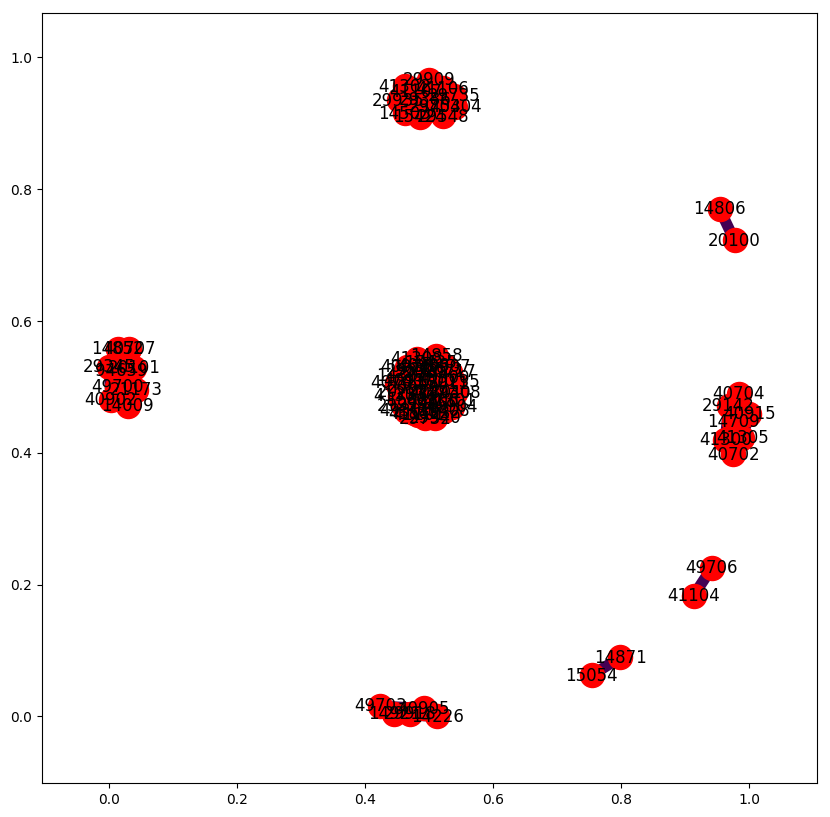

In [110]:
## re-calculate weights based on the new graph
weights=[edata['weight'] for f,t,edata in Wnet_trim.edges(data=True)]
plt.rcParams['figure.figsize'] = [10, 10]
nx.draw_networkx(Wnet_trim,width=weights, edge_color=weights)
#TODO lable nodes by name

In [111]:
Wnet_file = "S113_Island_2-0.graphml"
nx.write_graphml( Wnet_trim, Wnet_file )

In [126]:
g_islands = list(nx.connected_component_subgraphs(Wnet_trim))
len(g_islands)
#g_s113 = graphs[0]
#len(g_s113.nodes())

for g in g_islands:
    #print("island")
    #sens = g.nodes()
    df1 = (s113_members_sel_df[s113_members_sel_df['icpsr'].isin(g.nodes())][['bioname','nominate_dim1']])
    print(df1)
    #s113_members_sel_df

              bioname  nominate_dim1
57        REID, Harry         -0.276
77  WYDEN, Ronald Lee         -0.330
              bioname  nominate_dim1
5         FLAKE, Jeff          0.855
26  COATS, Daniel Ray          0.375
                                bioname  nominate_dim1
3                          BEGICH, Mark         -0.235
7                           PRYOR, Mark         -0.199
8                        BOXER, Barbara         -0.450
9                     FEINSTEIN, Dianne         -0.268
10                          UDALL, Mark         -0.353
11                   BENNET, Michael F.         -0.229
12                  MURPHY, Christopher         -0.270
13                  BLUMENTHAL, Richard         -0.437
15                COONS, Christopher A.         -0.230
20                        HIRONO, Mazie         -0.512
21                SCHATZ, Brian Emanuel         -0.446
24               DURBIN, Richard Joseph         -0.348
27                        DONNELLY, Joe         -0.119
38      

8 Islands; true

Island 1
- REID, Harry
- WYDEN, Ronald Lee

Island 2
- FLAKE, Jeff
- COATS, Daniel Ray

Name: bioname, dtype: object
3                            BEGICH, Mark
7                             PRYOR, Mark
8                          BOXER, Barbara
9                       FEINSTEIN, Dianne
10                            UDALL, Mark
11                     BENNET, Michael F.
12                    MURPHY, Christopher
13                    BLUMENTHAL, Richard
15                  COONS, Christopher A.
20                          HIRONO, Mazie
21                  SCHATZ, Brian Emanuel
24                 DURBIN, Richard Joseph
27                          DONNELLY, Joe
38                  MIKULSKI, Barbara Ann
39                 CARDIN, Benjamin Louis
42                      WARREN, Elizabeth
45                  STABENOW, Deborah Ann
46                         KLOBUCHAR, Amy
47                            FRANKEN, Al
59                        SHAHEEN, Jeanne
62                       MENENDEZ, Robert
64                   BOOKER, Cory Anthony
65                       HEINRICH, Martin
66                    UDALL, Thomas (Tom)
67         SCHUMER, Charles Ellis (Chuck)
68                    GILLIBRAND, Kirsten
70                             HAGAN, Kay
72         HEITKAMP, Mary Kathryn (Heidi)
74                         BROWN, Sherrod
78                          MERKLEY, Jeff
80               CASEY, Robert (Bob), Jr.
85           JOHNSON, Timothy Peter (Tim)
93                  LEAHY, Patrick Joseph
94                       SANDERS, Bernard
98                          MURRAY, Patty
99     ROCKEFELLER, John Davison IV (Jay)
101                        BALDWIN, Tammy


19                ISAKSON, Johnny
50                     BLUNT, Roy
56           FISCHER, Debra (Deb)
60                  AYOTTE, Kelly
69               BURR, Richard M.
71                   HOEVEN, John
73    PORTMAN, Robert Jones (Rob)
75         INHOFE, James Mountain
79         TOOMEY, Patrick Joseph
86                    THUNE, John
87               ALEXANDER, Lamar
91             HATCH, Orrin Grant

0      SESSIONS, Jefferson Beauregard III (Jeff)
1                             SHELBY, Richard C.
6                                  BOOZMAN, John
22                           CRAPO, Michael Dean
23                                  RISCH, James
30                ROBERTS, Charles Patrick (Pat)
48                         COCHRAN, William Thad
83                                    SCOTT, Tim
103                            BARRASSO, John A.

28               GRASSLEY, Charles Ernest
32    McCONNELL, Addison Mitchell (Mitch)
34                          VITTER, David
37                COLLINS, Susan Margaret
55                          JOHANNS, Mike

36         KING, Angus Stanley, Jr.
44                      LEVIN, Carl
53                      TESTER, Jon
81             REED, John F. (Jack)
82              WHITEHOUSE, Sheldon
96     KAINE, Timothy Michael (Tim)
100               MANCHIN, Joe, III

33           PAUL, Rand
104    ENZI, Michael B.


In [140]:
## The weights histogram is logarithmic;
## we should compute the original weight = e^log_weight
Wnet_trim=trim_edges(W, weight=math.exp(1.9))

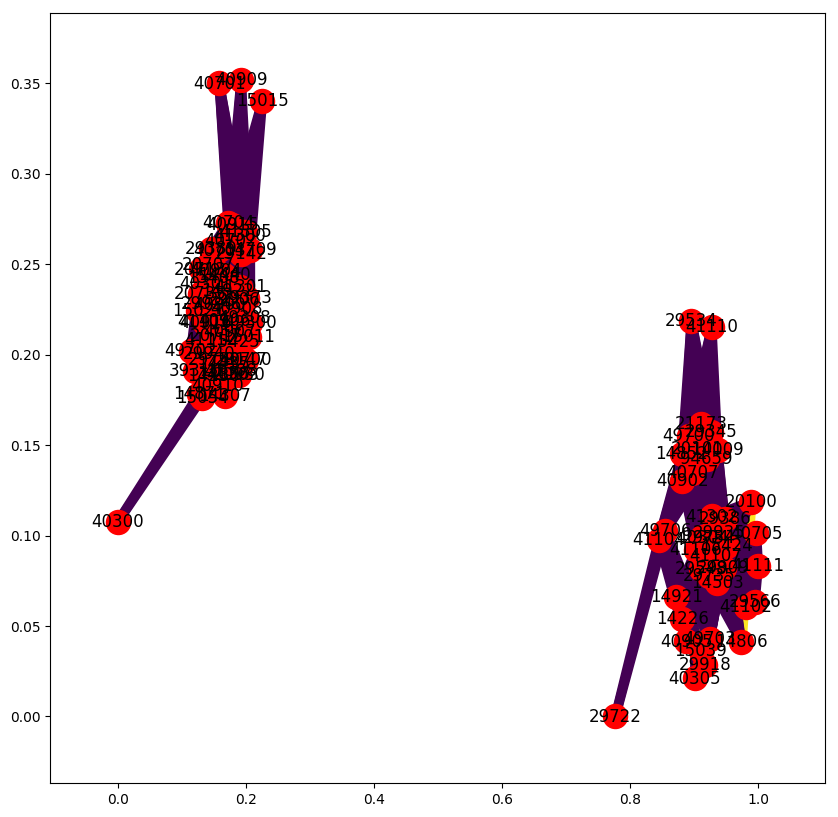

In [141]:
## re-calculate weights based on the new graph
weights=[edata['weight'] for f,t,edata in Wnet_trim.edges(data=True)]
nx.draw_networkx(Wnet_trim,width=weights, edge_color=weights)

In [143]:
g_islands = list(nx.connected_component_subgraphs(Wnet_trim))
len(g_islands)
#g_s113 = graphs[0]
#len(g_s113.nodes())

for g in g_islands:
    #print("island")
    #sens = g.nodes()
    df1 = (s113_members_sel_df[s113_members_sel_df['icpsr'].isin(g.nodes())][['bioname','party_code']])
    print(df1)
    #s113_members_sel_df

                                bioname party_code
2                       MURKOWSKI, Lisa        200
3                          BEGICH, Mark        100
7                           PRYOR, Mark        100
8                        BOXER, Barbara        100
9                     FEINSTEIN, Dianne        100
10                          UDALL, Mark        100
11                   BENNET, Michael F.        100
12                  MURPHY, Christopher        100
13                  BLUMENTHAL, Richard        100
14               CARPER, Thomas Richard        100
15                COONS, Christopher A.        100
20                        HIRONO, Mazie        100
21                SCHATZ, Brian Emanuel        100
24               DURBIN, Richard Joseph        100
27                        DONNELLY, Joe        100
29         HARKIN, Thomas Richard (Tom)        100
35                    LANDRIEU, Mary L.        100
36             KING, Angus Stanley, Jr.        328
38                MIKULSKI, Bar

In [127]:
## The weights histogram is logarithmic;
## we should compute the original weight = e^log_weight
Wnet_trim=trim_edges(W, weight=math.exp(1.77))

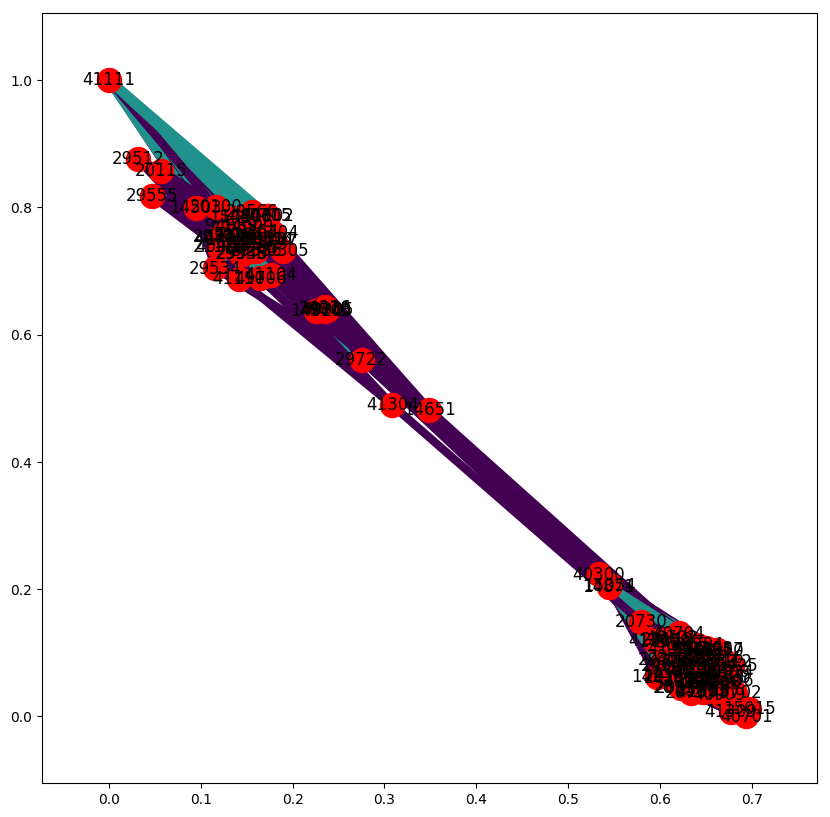

In [128]:
## re-calculate weights based on the new graph
plt.rcParams['figure.figsize'] = [10, 10]
weights=[edata['weight'] for f,t,edata in Wnet_trim.edges(data=True)]
nx.draw_networkx(Wnet_trim,width=weights, edge_color=weights)

In [129]:
Wnet_file = "S113_Island_1-77.graphml"
nx.write_graphml( Wnet_trim, Wnet_file )

In [107]:
# 41304, 11651, 29722

In [138]:
#Boundary spanner
bs_1 = ['14651']
bs_2 = ['14871','15054','40300']
bs_3 = ['49703','14226','29918','14921','40905','29722']

In [139]:
print(s113_members_sel_df[s113_members_sel_df['icpsr'].isin(bs_1)][['bioname','party_code','nominate_dim1']])
print(s113_members_sel_df[s113_members_sel_df['icpsr'].isin(bs_2)][['bioname','party_code','nominate_dim1']])
print(s113_members_sel_df[s113_members_sel_df['icpsr'].isin(bs_3)][['bioname','party_code','nominate_dim1']])

                            bioname party_code  nominate_dim1
16  NELSON, Clarence William (Bill)        100         -0.193
              bioname party_code  nominate_dim1
2     MURKOWSKI, Lisa        200          0.211
57        REID, Harry        100         -0.276
77  WYDEN, Ronald Lee        100         -0.330
                                bioname party_code  nominate_dim1
28             GRASSLEY, Charles Ernest        200          0.352
31                         MORAN, Jerry        200          0.418
32  McCONNELL, Addison Mitchell (Mitch)        200          0.404
34                        VITTER, David        200          0.495
37              COLLINS, Susan Margaret        200          0.115
55                        JOHANNS, Mike        200          0.391


# Scratch work

In [164]:
(senate_bills_df.loc[senate_bills_df['cc_for_def'] == 1])['bill_number']

244    S1197
316    S1963
325      S25
336    S1982
349    S1752
352    S1917
369    S2124
572    S2685
Name: bill_number, dtype: object

In [167]:
(s113_rollcalls_sel_df.loc[s113_rollcalls_sel_df['bill_number'] == 'S1197'])

,date,rollnumber,bill_number,vote_result,vote_desc,cc_agr,cc_civ_lib,cc_for_def,cc_gov_mgmt,cc_misc,cc_soc_wel
235,2013-11-18,236,S1197,Cloture on the Motion to Proceed Agreed to,An original bill to authorize appropriations f...,0,0,1,0,0,0
236,2013-11-19,237,S1197,Amendment Rejected,To propose alternative requirements and limita...,0,0,1,0,0,0
237,2013-11-19,238,S1197,Amendment Rejected,"To propose an alternative to section 1033, rel...",0,0,1,0,0,0
244,2013-11-21,245,S1197,Cloture Motion Rejected,An original bill to authorize appropriations f...,0,0,1,0,0,0
